In [74]:
### Hyperparameters

## Image and label
IMG_SIZE = 64
SKETCH_CHANNELS = 3
IMAGE_CHANNELS = 3

## Dataset and loader
BATCH_SIZE = 5
NUM_WORKERS = 8

## Model and training
NUM_EPOCHS = 20
DIS_LR = 1e-4
GEN_LR = 1e-4
NOISE_DIM = 100
FEATURES_DIS = 64
FEATURES_GEN = 64
NOISE_DIM = 100
CRITIC_ITERATIONS = 5
LAMBDA_GP = 10.0
BETA1 = 0.0
BETA2 = 0.9

# Imports and Dataset

In [75]:
### Imports

import numpy as np
from keras.preprocessing.image import img_to_array
import matplotlib.pyplot as plt
import cv2
from tqdm import tqdm 
import os
import re
import zipfile
import torch
import torch.nn as nn
from torch.utils.data import DataLoader, Dataset
import torchvision
import torchvision.transforms as transforms
from torch.utils.tensorboard import SummaryWriter
from tqdm import tqdm
import numpy as np
import zipfile
import matplotlib.pyplot as plt
import joblib
import warnings
warnings.filterwarnings("ignore")
%load_ext tensorboard
np.random.seed(42)
torch.manual_seed(42)
device = 'cuda' if torch.cuda.is_available() else 'cpu'
print(device)

The tensorboard extension is already loaded. To reload it, use:
  %reload_ext tensorboard
cuda


In [76]:
from google.colab import drive
drive.mount('/content/drive')

Drive already mounted at /content/drive; to attempt to forcibly remount, call drive.mount("/content/drive", force_remount=True).


In [77]:
### Dataset directory
data_dir = '/content/drive/MyDrive/Datasets/'

# ### Unzip custom dataset
# with zipfile.ZipFile(data_dir+'sketch_photos.zip', 'r') as zip_ref:
#     zip_ref.extractall(data_dir)

In [78]:
# to get the files in proper order
def sorted_alphanumeric(data):  
    convert = lambda text: int(text) if text.isdigit() else text.lower()
    alphanum_key = lambda key: [convert(c) for c in re.split('([0-9]+)',key)]
    return sorted(data,key = alphanum_key)


# defining the size of image 
SIZE = IMG_SIZE

image_path = data_dir + 'sketch_photos/photos'
img_array = []

sketch_path = data_dir + 'sketch_photos/sketches'
sketch_array = []

image_file = sorted_alphanumeric(os.listdir(image_path))
sketch_file = sorted_alphanumeric(os.listdir(sketch_path))


for i in tqdm(image_file):
    image = cv2.imread(image_path + '/' + i,1)
    
    # as opencv load image in bgr format converting it to rgb
    image = cv2.cvtColor(image, cv2.COLOR_BGR2RGB)
    
    # resizing images 
    image = cv2.resize(image, (SIZE, SIZE))
    
    # normalizing image 
    # image = image.astype('float32') / 255.0
    
    #appending normal normal image    
    img_array.append(img_to_array(image).astype(np.uint8))

    # Image Augmentation
    
    # horizontal flip 
    img1 = cv2.flip(image,1)
    img_array.append(img_to_array(img1).astype(np.uint8))
     #vertical flip 
    img2 = cv2.flip(image,-1)
    img_array.append(img_to_array(img2).astype(np.uint8))
     #vertical flip 
    img3 = cv2.flip(image,-1)
    # horizontal flip
    img3 = cv2.flip(img3,1)
    img_array.append(img_to_array(img3).astype(np.uint8))
    # rotate clockwise 
    img4 = cv2.rotate(image, cv2.ROTATE_90_CLOCKWISE)
    img_array.append(img_to_array(img4).astype(np.uint8))
    # flip rotated image 
    img5 = cv2.flip(img4,1)
    img_array.append(img_to_array(img5).astype(np.uint8))
     # rotate anti clockwise 
    img6 = cv2.rotate(image, cv2.ROTATE_90_COUNTERCLOCKWISE)
    img_array.append(img_to_array(img6).astype(np.uint8))
    # flip rotated image 
    img7 = cv2.flip(img6,1)
    img_array.append(img_to_array(img7).astype(np.uint8))
  
    
for i in tqdm(sketch_file):
    image = cv2.imread(sketch_path + '/' + i,1)
    
    # as opencv load image in bgr format converting it to rgb
    image = cv2.cvtColor(image, cv2.COLOR_BGR2RGB)
    
    # resizing images 
    image = cv2.resize(image, (SIZE, SIZE))
    
    # normalizing image 
    # image = image.astype('float32') / 255.0
    # appending normal sketch image
    sketch_array.append(img_to_array(image).astype(np.uint8))
    
    #Image Augmentation
    # horizontal flip 
    img1 = cv2.flip(image,1)
    sketch_array.append(img_to_array(img1).astype(np.uint8))
     #vertical flip 
    img2 = cv2.flip(image,-1)
    sketch_array.append(img_to_array(img2).astype(np.uint8))
     #vertical flip 
    img3 = cv2.flip(image,-1)
    # horizontal flip
    img3 = cv2.flip(img3,1)
    sketch_array.append(img_to_array(img3).astype(np.uint8))
    # rotate clockwise 
    img4 = cv2.rotate(image, cv2.ROTATE_90_CLOCKWISE)
    sketch_array.append(img_to_array(img4).astype(np.uint8))
    # flip rotated image 
    img5 = cv2.flip(img4,1)
    sketch_array.append(img_to_array(img5).astype(np.uint8))
     # rotate anti clockwise 
    img6 = cv2.rotate(image, cv2.ROTATE_90_COUNTERCLOCKWISE)
    sketch_array.append(img_to_array(img6).astype(np.uint8))
    # flip rotated image 
    img7 = cv2.flip(img6,1)
    sketch_array.append(img_to_array(img7).astype(np.uint8))

100%|██████████| 188/188 [00:00<00:00, 322.34it/s]


In [79]:
print("Total number of sketch images:",len(sketch_array))
print("Total number of images:",len(img_array))

Total number of sketch images: 1504
Total number of images: 1504


In [80]:
# CUHK Dataset

class CUHK_Dataset(Dataset):
    def __init__(self, sketches, images, sketch_transforms=None, image_transforms=None):
        self.sketches = sketches
        self.images = images
        self.sketch_transforms = sketch_transforms
        self.image_transforms = image_transforms
    
    def __len__(self):
        return len(self.images)
    
    def __getitem__(self, i):
        sketch, image = self.sketches[i], self.images[i]
        
        if self.sketch_transforms is not None:
            sketch = self.sketch_transforms(sketch)
        if self.image_transforms is not None:
            image = self.image_transforms(image)
        return sketch, image

In [81]:
sketch_trfm = transforms.Compose([
    transforms.ToPILImage(),             
    transforms.ToTensor(),
    transforms.Normalize(mean=[0.5] * SKETCH_CHANNELS, std=[0.5] * SKETCH_CHANNELS)
])

image_trfm = transforms.Compose([
    transforms.ToPILImage(),             
    transforms.ToTensor(),
    transforms.Normalize(mean=[0.5] * IMAGE_CHANNELS, std=[0.5] * IMAGE_CHANNELS)
])
dataset = CUHK_Dataset(np.array(sketch_array), np.array(img_array), sketch_trfm, image_trfm)
loader = DataLoader(dataset, batch_size=BATCH_SIZE, shuffle=True, num_workers=NUM_WORKERS)

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


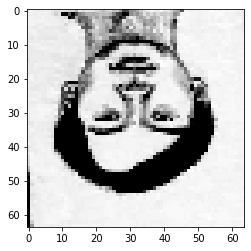

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


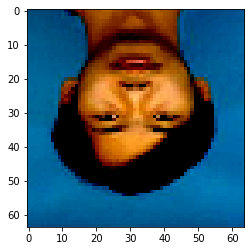

In [82]:
sketches, images = next(iter(loader))
plt.imshow(sketches[0].permute(1,2,0))
plt.show()
plt.imshow(images[0].permute(1,2,0))
plt.show()

# Model

In [83]:
### Discriminator And Generator Classes

class Discriminator(nn.Module):
    def __init__(self, channels, features_d, img_size):
        super().__init__()
        self.img_size = img_size

        self.conv1 = nn.Conv2d(channels + 3, features_d, kernel_size=4, stride=2, padding=1)
        self.relu = nn.LeakyReLU(0.2)
        self.conv2 = self.conv_block(features_d , features_d*2)
        self.conv3 = self.conv_block(features_d*2 ,features_d*4)
        self.conv4 = self.conv_block(features_d*4 ,features_d*8)

        self.conv5 = nn.Conv2d(features_d*8, 1, kernel_size=4, stride=2, padding=0)
    
    def forward(self, sketches, images):
        # concat sketch
        x = torch.cat([sketches, images], dim=1)

        # Conv
        out = self.relu(self.conv1(x))
        out = self.conv2(out)
        out = self.conv3(out)
        out = self.conv4(out)
        out = self.conv5(out)
        return out.view(-1)
    
    def conv_block(self, in_channels, out_channels, k=4, s=2, p=1, t=1):
        layers = []
        for _ in range(t):
            layers += [nn.Conv2d(in_channels, out_channels, kernel_size=k, stride=s, padding=p), 
                        nn.LeakyReLU(inplace=True, negative_slope=0.2),
                        nn.InstanceNorm2d(out_channels, affine=True)]               # Layer norm
        return nn.Sequential(*layers)


class Generator(nn.Module):
    def __init__(self, noise_dim, channels, features_d, img_size):
        super().__init__()
        self.noise_process = nn.Sequential(
            self.convT_block(noise_dim, features_d*8, p=0),
            self.convT_block(features_d*8, features_d*4),
            self.convT_block(features_d*4, features_d*2),
            self.convT_block(features_d*2, features_d),
            self.convT_block(features_d, SKETCH_CHANNELS),
        )
        self.sketch_process = self.conv_block(SKETCH_CHANNELS*2, features_d*8)
        self.conv1 = self.conv_block(features_d*8 , features_d*4)
        self.conv2 = self.conv_block(features_d*4 , features_d*2)
        self.conv3 = self.conv_block(features_d*2 , features_d)
        self.conv4 = nn.Conv2d(features_d, channels, kernel_size=3, stride=1, padding=1)
        self.tanh = nn.Tanh()
        
    
    def forward(self, noise, sketch):
        noise = self.noise_process(noise)
        sketch = torch.cat([noise, sketch], dim=1)
        out = self.sketch_process(sketch)
        # conv
        out = self.conv1(out)
        out = self.conv2(out)
        out = self.conv3(out)
        out = self.tanh(self.conv4(out))
        return out
    
    def conv_block(self, in_channels, out_channels, k=3, s=1, p=1, t=1):
        layers = []
        for _ in range(t):
            layers += [nn.Conv2d(in_channels, out_channels, kernel_size=k, stride=s, padding=p), 
                        nn.LeakyReLU(0.2, inplace=True),
                        nn.BatchNorm2d(out_channels)]
        return nn.Sequential(*layers)

    def convT_block(self, in_channels, out_channels, k=4, s=2, p=1, t=1):
        layers = []
        for _ in range(t):
            layers += [nn.ConvTranspose2d(in_channels, out_channels, kernel_size=k, stride=s, padding=p), 
                        nn.ReLU(inplace=True),
                        nn.BatchNorm2d(out_channels)]
        return nn.Sequential(*layers)


### Debug Classes

def test_dis_gen():
    with torch.no_grad():
        d = Discriminator(IMAGE_CHANNELS, FEATURES_DIS, IMG_SIZE)
        sketches, images = next(iter(loader))
        print(d(sketches, images).shape)
        assert list(d(sketches, images).shape) == [BATCH_SIZE]

        g = Generator(NOISE_DIM, IMAGE_CHANNELS, FEATURES_GEN, IMG_SIZE)
        sketches, images = next(iter(loader))
        noise = torch.randn((BATCH_SIZE, NOISE_DIM, 1, 1))
        print(g(noise, sketches).shape)
        assert list(g(noise, sketches).shape) == [BATCH_SIZE, IMAGE_CHANNELS, IMG_SIZE, IMG_SIZE]

test_dis_gen()

torch.Size([5])
torch.Size([5, 3, 64, 64])


In [84]:
def initialize_weights(model):
    # Initializes weights according to the DCGAN paper
    for m in model.modules():
        if isinstance(m, (nn.Conv2d, nn.ConvTranspose2d, nn.BatchNorm2d)):
            nn.init.normal_(m.weight.data, 0.0, 0.02)

def gradient_penalty(critic, real, fake, sketches):
    BATCH_SIZE, C, H, W = real.shape
    epsilon = torch.rand((BATCH_SIZE, 1, 1, 1)).repeat(1, C, H, W).to(device)
    interpolated_images = real * epsilon + fake * (1 - epsilon)
    mixed_scores = critic(sketches,interpolated_images)
    gradient = torch.autograd.grad(
        inputs=interpolated_images,
        outputs=mixed_scores,
        grad_outputs=torch.ones_like(mixed_scores),
        create_graph=True,
        retain_graph=True
    )[0]
    gradient.view(gradient.shape[0], -1)
    gradient_norm = gradient.norm(2, dim=1)
    gradient_penalty = torch.mean((gradient_norm - 1) ** 2)
    return gradient_penalty

In [85]:
### Model Inits

critic = Discriminator(IMAGE_CHANNELS, FEATURES_DIS, IMG_SIZE).to(device)
gen = Generator(NOISE_DIM, IMAGE_CHANNELS, FEATURES_GEN, IMG_SIZE).to(device)

initialize_weights(critic)
initialize_weights(gen)

opt_critic = torch.optim.Adam(critic.parameters(), lr=DIS_LR, betas=(BETA1, BETA2))
opt_gen = torch.optim.Adam(gen.parameters(), lr=GEN_LR, betas=(BETA1, BETA2))

# Training

In [86]:
### Watch progress
!rm -r logs
!mkdir logs
!mkdir logs/fake
!mkdir logs/real
writer_fake = SummaryWriter('./logs/fake/')
writer_real = SummaryWriter('./logs/real/')
step = 0
%tensorboard --logdir logs

Reusing TensorBoard on port 6006 (pid 7354), started 0:00:25 ago. (Use '!kill 7354' to kill it.)

<IPython.core.display.Javascript object>

In [87]:
### Training GAN
%%time

for epoch in range(NUM_EPOCHS):
    for batch_idx, (sketches, real) in enumerate(loader):
        sketches = sketches.to(device)
        real = real.to(device)
        bs = sketches.shape[0]

        ### Training Critic maximize -> -(D(real) - D(G(z)))
        for _ in range(CRITIC_ITERATIONS):
            noise = torch.randn((bs, NOISE_DIM, 1, 1)).to(device)
            fake = gen(noise, sketches)
            critic_real = critic(sketches, real)
            critic_fake = critic(sketches, fake)
            gp = gradient_penalty(critic, real, fake, sketches)
            loss_critic = - (torch.mean(critic_real) - torch.mean(critic_fake)) + LAMBDA_GP * gp
            critic.zero_grad()
            loss_critic.backward(retain_graph=True)
            opt_critic.step()

        ### Train Generator  maximize -> -D(G(z))
        output = critic(sketches, fake)
        loss_gen = -torch.mean(output)
        gen.zero_grad()
        loss_gen.backward()
        opt_gen.step()
        if batch_idx % 100 == 0:
            print(
                f"Epoch [{epoch}/{NUM_EPOCHS}] Batch {batch_idx}/{len(loader)} \
                      Loss critic: {loss_critic:.4f}, Loss generator: {loss_gen:.4f}, Step: {step}"
            )

            with torch.no_grad():
                fake = gen(noise, sketches)
                data = real
                img_grid_fake = torchvision.utils.make_grid(fake[:min(32, bs)], normalize=True)
                img_grid_real = torchvision.utils.make_grid(data[:min(32, bs)], normalize=True)

                writer_fake.add_image(
                    "Fake Images", img_grid_fake, global_step=step
                )
                writer_real.add_image(
                    "Real Images", img_grid_real, global_step=step
                )
                step += 1

Epoch [0/20] Batch 0/301                       Loss critic: -108.3094, Loss generator: 69.9375, Step: 0
Epoch [0/20] Batch 100/301                       Loss critic: -2246.3997, Loss generator: 1128.3790, Step: 1
Epoch [0/20] Batch 200/301                       Loss critic: -4103.3677, Loss generator: 2067.5623, Step: 2
Epoch [0/20] Batch 300/301                       Loss critic: -5365.5884, Loss generator: 2502.1301, Step: 3
Epoch [1/20] Batch 0/301                       Loss critic: -5656.2954, Loss generator: 2669.9233, Step: 4
Epoch [1/20] Batch 100/301                       Loss critic: -7913.5498, Loss generator: 4145.9097, Step: 5
Epoch [1/20] Batch 200/301                       Loss critic: -8331.6162, Loss generator: 4756.9678, Step: 6
Epoch [1/20] Batch 300/301                       Loss critic: -8174.7280, Loss generator: 4343.3159, Step: 7
Epoch [2/20] Batch 0/301                       Loss critic: -8129.5420, Loss generator: 6162.3594, Step: 8
Epoch [2/20] Batch 100/301  

# Save and Test

In [88]:
torch.save(gen, '/content/drive/MyDrive/Models/CUHK_cWGAN-GP1.model')

In [89]:
generator = torch.load('/content/drive/MyDrive/Models/CUHK_cWGAN-GP1.model')

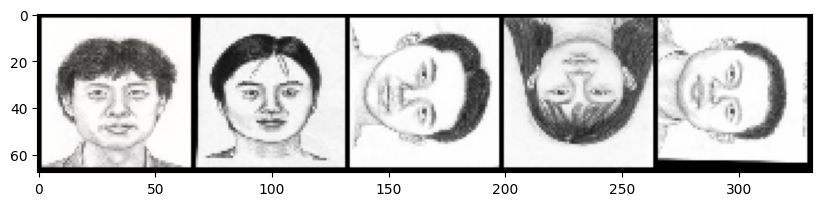

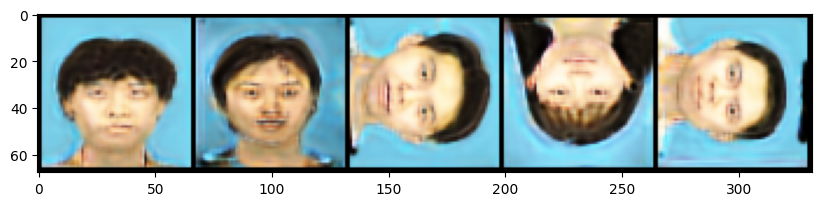

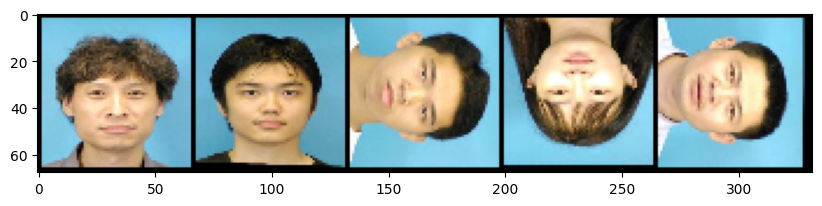

In [97]:
# import random.randint as randi
# sketch = dataset[randi(1000)][0]

with torch.no_grad():
    
    noise = torch.randn((BATCH_SIZE, NOISE_DIM, 1, 1)).to(device)
    sketches, real = next(iter(loader))
    images = gen(noise, sketches.to(device)).cpu()
    skt_grid = torchvision.utils.make_grid(sketches, normalize=True)
    img_grid = torchvision.utils.make_grid(images, normalize=True)
    real_grid = torchvision.utils.make_grid(real, normalize=True)
    plt.figure(figsize=(10,5), dpi=100)
    plt.imshow(skt_grid.cpu().permute(1,2,0))
    plt.show()
    plt.figure(figsize=(10,5), dpi=100)
    plt.imshow(img_grid.cpu().permute(1,2,0))
    plt.show()
    plt.figure(figsize=(10,5), dpi=100)
    plt.imshow(real_grid.cpu().permute(1,2,0))
    plt.show()